In [4]:
#necessary imports
import pandas as pd
import geopandas as gpd
import numpy as np
from pyproj import Proj, transform
import rasterio
from PIL import Image
import matplotlib.pyplot as plt
import cv2
import random
from deepforest import main
from deepforest import get_data

In [2]:
#setting the base dataset. This will be the dataset I used to train the model in streamlined_model.py 
df = pd.read_csv('final_dataset_filtered.csv') 

In [3]:
df

,img_path,xmin,ymin,xmax,ymax,score,img_name,tile_index,tile_xmin,tile_ymin,...,site,X_g,Y_g,updated diameter,group,updated height,AGB,carbon,id,unique_id
0,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,3332.557861,19.092411,3661.390137,364.616425,0.531211,Carlos Vera Guevara RGB,3,0,8305,...,Carlos Vera Guevara RGB,5298.555843,7709.844671,10.281385,banana,0.0,4.293300,1.674387,30,1
1,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,3162.579834,2148.233398,3431.632324,2379.467041,0.511510,Carlos Vera Guevara RGB,3,0,8305,...,Carlos Vera Guevara RGB,5315.345160,8606.745732,13.528139,banana,0.0,7.702971,3.004159,112,2
2,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,2893.605713,244.011108,3095.620605,451.257812,0.251310,Carlos Vera Guevara RGB,3,0,8305,...,Carlos Vera Guevara RGB,5228.142461,7935.770200,12.732366,banana,0.0,6.769828,2.640233,179,3
3,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,2595.111084,1703.712402,2765.227295,1865.253418,0.217742,Carlos Vera Guevara RGB,3,0,8305,...,Carlos Vera Guevara RGB,4434.058601,8354.081799,9.867583,banana,0.0,3.933601,1.534104,93,4
4,Carlos Vera Guevara RGB_10_7600_7600_11600_116...,249.691879,123.626862,439.557648,302.768402,0.282849,Carlos Vera Guevara RGB,10,7600,7600,...,Carlos Vera Guevara RGB,8257.952942,7554.538338,17.825312,banana,0.0,13.862143,5.406236,162,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2597,Nestor Macias RGB_3_0_9024_4000_13024.png,2664.345215,232.421860,2992.793945,577.599243,0.401987,Nestor Macias RGB,3,0,9024,...,Nestor Macias RGB,5083.016310,8395.427219,8.404929,other,0.0,16.643291,6.490884,167,2598
2598,Nestor Macias RGB_3_0_9024_4000_13024.png,3003.697266,15.084885,3288.265381,276.357574,0.356021,Nestor Macias RGB,3,0,9024,...,Nestor Macias RGB,5232.131207,8130.712274,8.785332,fruit,0.0,24.072524,9.388284,108,2599
2599,Nestor Macias RGB_3_0_9024_4000_13024.png,2624.353027,7.873686,2908.305420,132.604981,0.240188,Nestor Macias RGB,3,0,9024,...,Nestor Macias RGB,5162.918189,8152.987700,8.359419,cacao,2.2,8.090504,3.155296,162,2600
2600,Nestor Macias RGB_10_7600_7600_11600_11600.png,1168.633789,1419.221558,1340.020508,1599.804932,0.455914,Nestor Macias RGB,10,7600,7600,...,Nestor Macias RGB,9463.438380,8020.578424,5.220658,cacao,1.5,3.185392,1.242303,500,2601


Getting this df into the shape deepforest expects. 

In [4]:
deepforest_data = df[['img_path', 'xmin', 'ymin', 'xmax', 'ymax', 'unique_id']]
deepforest_data['label'] = 'Tree'

/var/folders/ym/hz9zm7z56_z32pf0g7q1mxdw0000gp/T/ipykernel_56030/1750516733.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  deepforest_data['label'] = 'Tree'


In [5]:
#rename img_path to image_path
deepforest_data = deepforest_data.rename(columns={'img_path': 'image_path'})

#### Aligning test set with other test data 

In [16]:
#I also need to split the train/test/val like I did in that model 
#the most important is that the test data aligns and I have that saved 

test_data = pd.read_csv('test_df_proper.csv')
test_data_deepforest = test_data[['img_path', 'xmin', 'ymin', 'xmax', 'ymax', 'unique_id']]
test_data_deepforest['label'] = 'Tree'
test_data_deepforest = test_data_deepforest.rename(columns={'img_path': 'image_path'})


/var/folders/ym/hz9zm7z56_z32pf0g7q1mxdw0000gp/T/ipykernel_24189/2267634518.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_data_deepforest['label'] = 'Tree'


In [9]:
#now I need to remove that test data from the original dataset
deepforest_data = deepforest_data[~deepforest_data['unique_id'].isin(test_data_deepforest['unique_id'])]

In [10]:
deepforest_data

,image_path,xmin,ymin,xmax,ymax,unique_id,label
0,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,3332.557861,19.092411,3661.390137,364.616425,1,Tree
1,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,3162.579834,2148.233398,3431.632324,2379.467041,2,Tree
2,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,2893.605713,244.011108,3095.620605,451.257812,3,Tree
3,Carlos Vera Guevara RGB_3_0_8305_4000_12305.png,2595.111084,1703.712402,2765.227295,1865.253418,4,Tree
4,Carlos Vera Guevara RGB_10_7600_7600_11600_116...,249.691879,123.626862,439.557648,302.768402,5,Tree
...,...,...,...,...,...,...,...
2593,Nestor Macias RGB_8_7600_0_11600_4000.png,7.384966,550.529236,137.690369,840.839172,2594,Tree
2594,Nestor Macias RGB_8_7600_0_11600_4000.png,3306.276611,2781.378906,3542.056885,3022.310547,2595,Tree
2595,Nestor Macias RGB_8_7600_0_11600_4000.png,1771.353394,1340.999268,2014.887329,1571.038574,2596,Tree
2600,Nestor Macias RGB_10_7600_7600_11600_11600.png,1168.633789,1419.221558,1340.020508,1599.804932,2601,Tree


In [11]:
test_data_deepforest

,image_path,xmin,ymin,xmax,ymax,unique_id,label
0,Carlos Vera Guevara RGB_8_7600_0_11600_4000.png,129.349701,2401.047852,297.645569,2573.562988,6,Tree
1,Carlos Vera Guevara RGB_8_7600_0_11600_4000.png,1542.123047,3868.145996,1757.826660,3997.536621,7,Tree
2,Carlos Vera Guevara RGB_8_7600_0_11600_4000.png,1347.086304,2774.218750,1606.083862,3041.552979,8,Tree
3,Carlos Vera Guevara RGB_8_7600_0_11600_4000.png,289.777344,1570.390015,562.296753,1841.121460,9,Tree
4,Carlos Vera Guevara RGB_8_7600_0_11600_4000.png,490.461182,2160.999268,677.117859,2363.269775,10,Tree
...,...,...,...,...,...,...,...
297,Nestor Macias RGB_7_3800_9024_7800_13024.png,729.080017,1964.524292,913.531433,2151.624268,2547,Tree
298,Nestor Macias RGB_3_0_9024_4000_13024.png,2535.598389,586.687805,2797.748535,822.798645,2597,Tree
299,Nestor Macias RGB_3_0_9024_4000_13024.png,2664.345215,232.421860,2992.793945,577.599243,2598,Tree
300,Nestor Macias RGB_3_0_9024_4000_13024.png,3003.697266,15.084885,3288.265381,276.357574,2599,Tree


Good. This confirms I have removed the correct number of rows from the overall dataframe. Now I can split my training and val data the same way I did in streamlined_model. 

In [12]:
remaining_size = len(deepforest_data['image_path'].unique())
print(remaining_size)
train_size = int(0.7 * remaining_size)
print(train_size)
val_size = int(0.3 * remaining_size)
print(val_size)

80
56
24


In [13]:
tiles = deepforest_data['image_path'].unique()
np.random.seed(42)
np.random.shuffle(tiles)

# Calculate split indices
train_end = train_size
val_end = train_end + val_size

train_tiles = tiles[:train_end]
val_tiles = tiles[train_end:val_end]

# Filter DataFrames
train_df = deepforest_data[deepforest_data['image_path'].isin(train_tiles)]
val_df = deepforest_data[deepforest_data['image_path'].isin(val_tiles)]

# Output sizes
print(f'Training set size: {len(train_df)}')
print(f'Validation set size: {len(val_df)}')

Training set size: 1735
Validation set size: 565


In [14]:
#save all of these as CSVs 
train_df.to_csv('corrected_train_df_deepforest.csv', index=False)
val_df.to_csv('corrected_val_df_deepforest.csv', index=False)
test_data_deepforest.to_csv('corrected_test_df_deepforest.csv', index=False)

NB: This is not exactly the same as the training/val split we saw in the SEDD model because of the randomness, but since there is no data leakage with the test set it should be okay. 

### Setting the Deep Forest model

In [15]:
m = main.deepforest()
m.config['gpus'] = '-1' #move to GPU and use all the GPU resources
m.config["train"]["csv_file"] = 'corrected_train_df_deepforest.csv'
m.config["train"]["root_dir"] = 'data/tiles/processed'
m.config["score_thresh"] = 0.4
m.config["train"]['epochs'] = 10
m.config["validation"]["csv_file"] = 'corrected_val_df_deepforest.csv'
m.config["validation"]["root_dir"] = 'data/tiles/processed'
#create a pytorch lighting trainer used to training
m.create_trainer()
#load the lastest release model
m.use_release()

Reading config file: /opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/data/deepforest_config.yml


GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


No validation file provided. Turning off validation loop
Model from DeepForest release https://github.com/weecology/DeepForest/releases/tag/1.0.0 was already downloaded. Loading model from file.
Loading pre-built model: https://github.com/weecology/DeepForest/releases/tag/1.0.0


In [16]:
import time
start_time = time.time()
m.trainer.fit(m)
print(f"--- Training: {(time.time() - start_time):.2f} seconds ---")

Missing logger folder: /Users/ger23/Desktop/irp-ger23/ReforesTree/lightning_logs
/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "

  | Name       | Type                  | Params | Mode 
-------------------------------------------------------------
0 | model      | RetinaNet             | 32.1 M | train
1 | iou_metric | IntersectionOverUnion | 0      | train
2 | mAP_metric | MeanAveragePrecision  | 0      | train
-------------------------------------------------------------
31.9 M    Trainable params
222 K     Non-trainable params
32.1 M    Total params
128.592   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/albumentations/core/composition.py:144: UserWarning: Got processor for bboxes, but no transform to process it.
  self._set_keys()
/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:419: Consider setting `persistent_workers=True` in 'val_dataloader' to speed up the dataloader worker initialization.
INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Sanity Checking DataLoader 0: 100%|██████████| 2/2 [00:03<00:00,  0.60it/s]

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/pytorch_lightning/utilities/data.py:78: Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 3. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.


/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/evaluate.py:193: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  results = pd.concat(results)
/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:419: Consider setting `persistent_workers=True` in 'train_dataloader' to speed up the dataloader worker initialization.


Epoch 0:   0%|          | 0/56 [00:00<?, ?it/s] 

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 0: 100%|██████████| 56/56 [01:09<00:00,  0.81it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 1:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 1: 100%|██████████| 56/56 [01:04<00:00,  0.87it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 2:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 2: 100%|██████████| 56/56 [01:05<00:00,  0.86it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 3:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 3: 100%|██████████| 56/56 [01:00<00:00,  0.92it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 4:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 4: 100%|██████████| 56/56 [01:00<00:00,  0.92it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 5:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 5: 100%|██████████| 56/56 [01:00<00:00,  0.93it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 6:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 6: 100%|██████████| 56/56 [01:00<00:00,  0.93it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 7:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 7: 100%|██████████| 56/56 [01:00<00:00,  0.93it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 8:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 8: 100%|██████████| 56/56 [01:02<00:00,  0.89it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/torchmetrics/utilities/prints.py:43: UserWarning: Encountered more than 100 detections in a single image. This means that certain detections with the lowest scores will be ignored, that may have an undesirable impact on performance. Please consider adjusting the `max_detection_threshold` to suit your use case. To disable this warning, set attribute class `warn_on_many_detections=False`, after initializing the metric.
  warnings.warn(*args, **kwargs)  # noqa: B028


Epoch 9:   0%|          | 0/56 [00:00<?, ?it/s, v_num=0]         

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 9: 100%|██████████| 56/56 [01:00<00:00,  0.92it/s, v_num=0]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.13 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Epoch 9: 100%|██████████| 56/56 [02:17<00:00,  0.41it/s, v_num=0]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|██████████| 56/56 [02:17<00:00,  0.41it/s, v_num=0]
--- Training: 1407.44 seconds ---


In [17]:
#save the model 
m.save_model("deepforest_model_corrected.pth")

In [11]:
#load the model 
m = main.deepforest.load_from_checkpoint("deepforest_model_corrected.pth")

Reading config file: /opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/data/deepforest_config.yml


GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


No validation file provided. Turning off validation loop


In [12]:
test_file = 'corrected_test_df_deepforest.csv'
results = m.evaluate(
    test_file,
    root_dir='data/tiles/processed',
    iou_threshold=0.1
)

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/albumentations/core/composition.py:144: UserWarning: Got processor for bboxes, but no transform to process it.
  self._set_keys()
/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:419: Consider setting `persistent_workers=True` in 'predict_dataloader' to speed up the dataloader worker initialization.


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.14 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Predicting DataLoader 0: 100%|██████████| 12/12 [00:12<00:00,  0.99it/s]


In [13]:
results['box_precision']

0.26991866507177437

In [14]:
results["box_recall"]

0.7157777207577901

In [17]:
unique_img_paths = test_data['img_path'].unique()

In [18]:
root_dir = 'data/tiles/processed/'

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


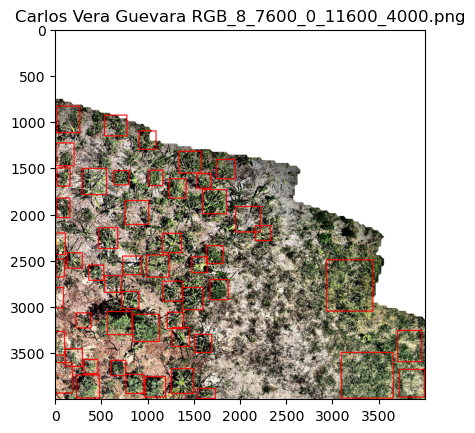

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


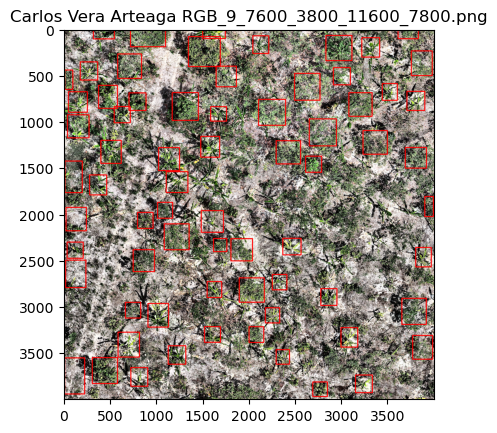

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


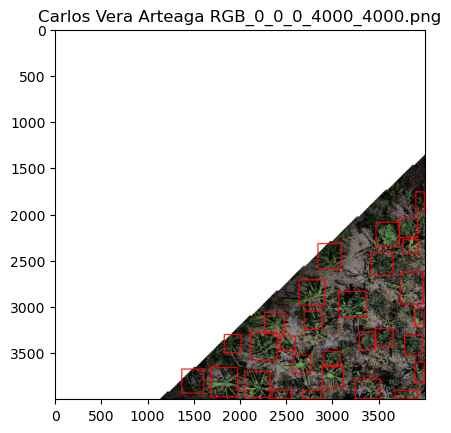

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


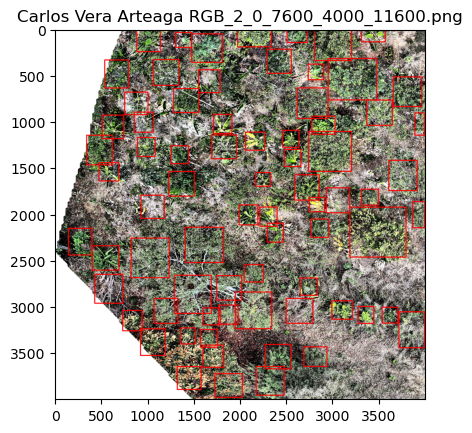

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


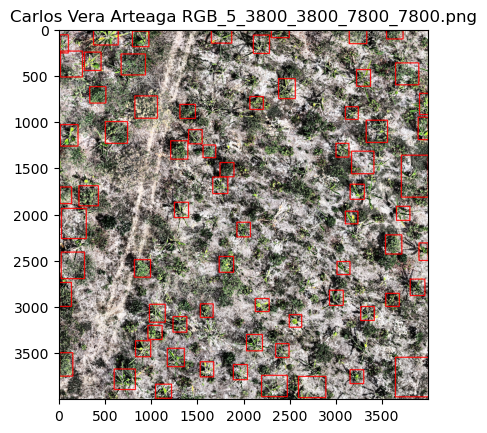

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


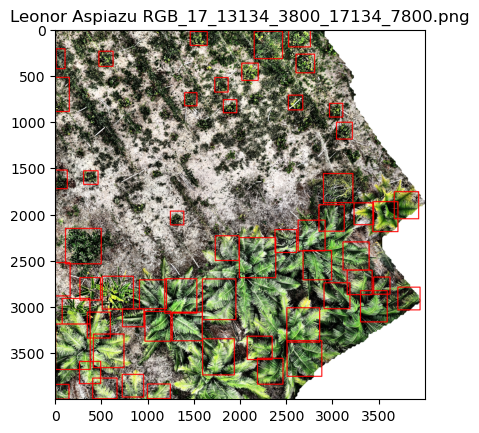

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


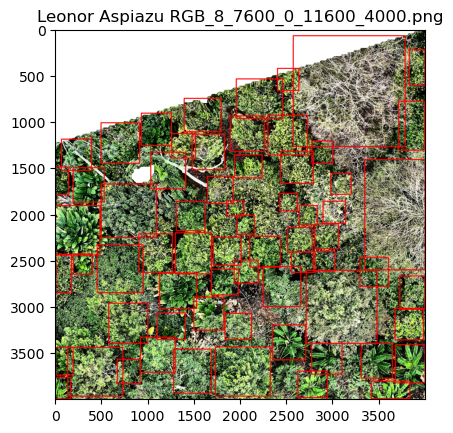

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


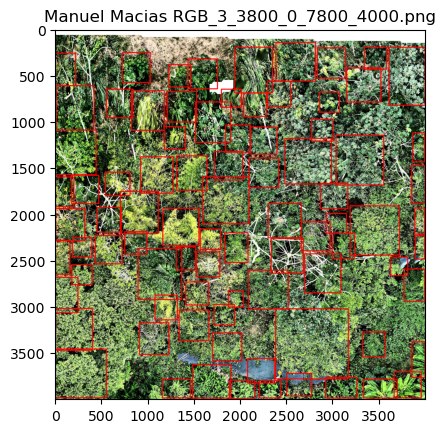

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


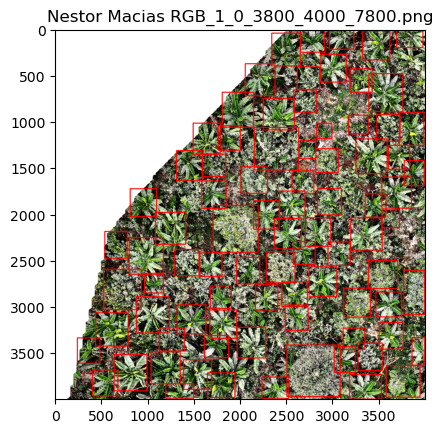

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


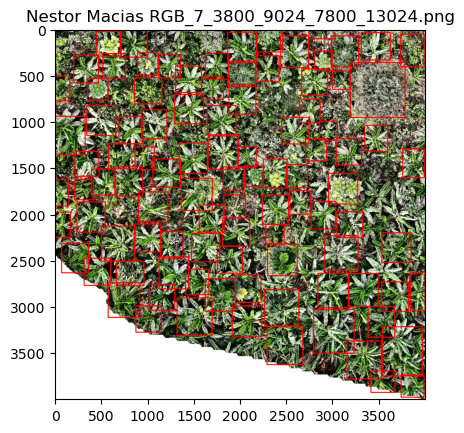

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


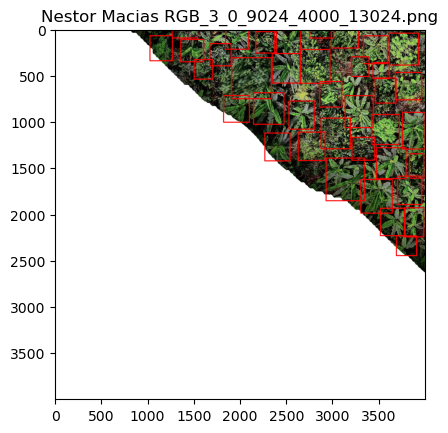

/opt/homebrew/Caskroom/miniconda/base/envs/IRP_2/lib/python3.9/site-packages/deepforest/main.py:338: UserWarning: Image type is uint8, transforming to float32. This assumes that the range of pixel values is 0-255, as opposed to 0-1.To suppress this warning, transform image (image.astype('float32')
  warnings.warn(f"Image type is {image.dtype}, transforming to float32. "


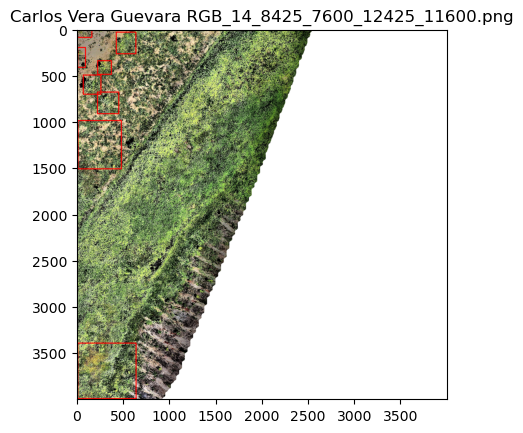

In [19]:
import os
for image_name in unique_img_paths:
    path = os.path.join(root_dir, image_name)
    image = Image.open(path)
    image = np.array(image)
    updated = m.predict_image(image, return_plot = True, color=(0, 0, 255), thickness=10)
    plt.imshow(updated[:,:,::-1])
    plt.title(image_name)
    plt.show()

In [20]:
#saving all the coordinates of these bounding boxes 
list_of_predictions = []
for image_name in unique_img_paths:
    path = os.path.join(root_dir, image_name)
    prediction = m.predict_image(path = path, return_plot = False)
    list_of_predictions.append(prediction)

In [21]:
list_of_predictions[11]

,xmin,ymin,xmax,ymax,label,score,image_path
0,67.0,497.0,258.0,704.0,Tree,0.239131,Carlos Vera Guevara RGB_14_8425_7600_12425_116...
1,8.0,3395.0,638.0,3995.0,Tree,0.234210,Carlos Vera Guevara RGB_14_8425_7600_12425_116...
2,1.0,6.0,160.0,90.0,Tree,0.202939,Carlos Vera Guevara RGB_14_8425_7600_12425_116...
3,223.0,342.0,371.0,489.0,Tree,0.187003,Carlos Vera Guevara RGB_14_8425_7600_12425_116...
4,7.0,199.0,91.0,413.0,Tree,0.177794,Carlos Vera Guevara RGB_14_8425_7600_12425_116...
5,424.0,33.0,636.0,267.0,Tree,0.143826,Carlos Vera Guevara RGB_14_8425_7600_12425_116...
6,10.0,989.0,479.0,1511.0,Tree,0.136660,Carlos Vera Guevara RGB_14_8425_7600_12425_116...
7,221.0,681.0,451.0,915.0,Tree,0.116367,Carlos Vera Guevara RGB_14_8425_7600_12425_116...


### Figuring out which box has the highest IoU with original image

In [22]:
def calculate_iou(box1, box2):
    """
    Calculate the Intersection over Union (IoU) of two bounding boxes.
    
    Args:
        box1: A list or tuple with the format [xmin, ymin, xmax, ymax].
        box2: A list or tuple with the format [xmin, ymin, xmax, ymax].
        
    Returns:
        IoU: The Intersection over Union value.
    """
    # Determine the coordinates of the intersection rectangle
    x_left = max(box1[0], box2[0])
    y_top = max(box1[1], box2[1])
    x_right = min(box1[2], box2[2])
    y_bottom = min(box1[3], box2[3])

    # Calculate the area of intersection
    if x_right < x_left or y_bottom < y_top:
        return 0.0  # No intersection

    intersection_area = (x_right - x_left) * (y_bottom - y_top)

    # Calculate the area of both bounding boxes
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])

    # Calculate the union area
    union_area = box1_area + box2_area - intersection_area

    # Calculate the IoU
    iou = intersection_area / union_area

    return iou

In [23]:
test_data_grouped = test_data.groupby('img_path')

In [24]:
tester_groundtruth = test_data_grouped.get_group('Carlos Vera Guevara RGB_14_8425_7600_12425_11600.png')

In [25]:
tester_predictions = list_of_predictions[11]

In [26]:
for _, true_box in tester_groundtruth.iterrows():
    true_bbox = [true_box['xmin'], true_box['ymin'], true_box['xmax'], true_box['ymax']]
    highest_iou = 0.0
    best_prediction = None

    for _, pred_box in tester_predictions.iterrows():
        pred_bbox = [pred_box['xmin'], pred_box['ymin'], pred_box['xmax'], pred_box['ymax']]
        iou = calculate_iou(true_bbox, pred_bbox)

        # Check if this IoU is the highest seen so far
        if iou > highest_iou:
            highest_iou = iou
            best_prediction = pred_box

    # Output the highest IoU and corresponding predicted box
    print(f"True Box: {true_bbox}")
    if best_prediction is not None:
        print(f"Best Prediction: {[best_prediction['xmin'], best_prediction['ymin'], best_prediction['xmax'], best_prediction['ymax']]} with IoU: {highest_iou:.2f}")
    else:
        print("No overlapping prediction found.")

True Box: [2.671545029, 271.9193726, 131.3592529, 477.8641052]
Best Prediction: [7.0, 199.0, 91.0, 413.0] with IoU: 0.36
True Box: [5.671545029, 274.9193726, 129.3592529, 475.8641052]
Best Prediction: [7.0, 199.0, 91.0, 413.0] with IoU: 0.37


Great that worked as I expected! Now I am going to do this for all the test images. 

In [27]:
#put unique image paths in a dictionary with integers as the keys 
unique_img_paths_dict = {}
for i, img_path in enumerate(unique_img_paths):
    unique_img_paths_dict[i] = img_path

In [28]:
unique_img_paths_dict

{0: 'Carlos Vera Guevara RGB_8_7600_0_11600_4000.png',
 1: 'Carlos Vera Arteaga RGB_9_7600_3800_11600_7800.png',
 2: 'Carlos Vera Arteaga RGB_0_0_0_4000_4000.png',
 3: 'Carlos Vera Arteaga RGB_2_0_7600_4000_11600.png',
 4: 'Carlos Vera Arteaga RGB_5_3800_3800_7800_7800.png',
 5: 'Leonor Aspiazu RGB_17_13134_3800_17134_7800.png',
 6: 'Leonor Aspiazu RGB_8_7600_0_11600_4000.png',
 7: 'Manuel Macias RGB_3_3800_0_7800_4000.png',
 8: 'Nestor Macias RGB_1_0_3800_4000_7800.png',
 9: 'Nestor Macias RGB_7_3800_9024_7800_13024.png',
 10: 'Nestor Macias RGB_3_0_9024_4000_13024.png',
 11: 'Carlos Vera Guevara RGB_14_8425_7600_12425_11600.png'}

In [29]:
image_path_to_index = {v: k for k, v in unique_img_paths_dict.items()}

In [30]:
iou_results = []
for group_key, group in test_data_grouped:
    image_path = group_key

    # Find the index for the current image path using the reversed dictionary
    number_of_image = image_path_to_index.get(image_path)
    
    if number_of_image is None:
        print(f"Image path {image_path} not found in the predictions list.")
        continue

    # Access the corresponding predictions for the current image
    curr = list_of_predictions[number_of_image]

    # Iterate over each true bounding box in the ground truth
    for _, true_box in group.iterrows():
        true_bbox = [true_box['xmin'], true_box['ymin'], true_box['xmax'], true_box['ymax']]
        highest_iou = 0.0
        best_prediction = None

        for _, pred_box in curr.iterrows():
            pred_bbox = [pred_box['xmin'], pred_box['ymin'], pred_box['xmax'], pred_box['ymax']]
            iou = calculate_iou(true_bbox, pred_bbox)

            # Check if this IoU is the highest seen so far
            if iou > highest_iou:
                highest_iou = iou
                best_prediction = pred_box

        if best_prediction is not None:
            iou_results.append({
                'true_box_xmin': true_bbox[0],
                'true_box_ymin': true_bbox[1],
                'true_box_xmax': true_bbox[2],
                'true_box_ymax': true_bbox[3],
                'pred_box_xmin': best_prediction['xmin'],
                'pred_box_ymin': best_prediction['ymin'],
                'pred_box_xmax': best_prediction['xmax'],
                'pred_box_ymax': best_prediction['ymax'],
                'image_path': image_path,
                'iou': highest_iou
            })
        else:
            # Print details when no best prediction is found
            print(f"No best prediction found for True Box: {true_bbox} in Image: {image_path}")

No best prediction found for True Box: [2015.06189, 508.5272522, 2187.251709, 665.835083] in Image: Carlos Vera Arteaga RGB_5_3800_3800_7800_7800.png
No best prediction found for True Box: [2018.06189, 511.5272522, 2185.251709, 663.835083] in Image: Carlos Vera Arteaga RGB_5_3800_3800_7800_7800.png
No best prediction found for True Box: [2675.786621, 937.0925903, 2887.776123, 1131.867065] in Image: Carlos Vera Arteaga RGB_5_3800_3800_7800_7800.png
No best prediction found for True Box: [2678.786621, 940.0925903, 2885.776123, 1129.867065] in Image: Carlos Vera Arteaga RGB_5_3800_3800_7800_7800.png
No best prediction found for True Box: [2084.394531, 3397.796387, 2270.294189, 3570.887207] in Image: Carlos Vera Arteaga RGB_9_7600_3800_11600_7800.png
No best prediction found for True Box: [2087.394531, 3400.796387, 2268.294189, 3568.887207] in Image: Carlos Vera Arteaga RGB_9_7600_3800_11600_7800.png
No best prediction found for True Box: [1690.512695, 3829.318848, 2103.86084, 3989.009033]

In [31]:
iou_results_df = pd.DataFrame(iou_results)

In [32]:
iou_results_df

,true_box_xmin,true_box_ymin,true_box_xmax,true_box_ymax,pred_box_xmin,pred_box_ymin,pred_box_xmax,pred_box_ymax,image_path,iou
0,1584.526001,3605.191895,2002.917725,3995.958496,1683.0,3658.0,1974.0,3976.0,Carlos Vera Arteaga RGB_0_0_0_4000_4000.png,0.566004
1,2576.547852,3521.658203,2761.131592,3715.515381,2565.0,3526.0,2762.0,3720.0,Carlos Vera Arteaga RGB_0_0_0_4000_4000.png,0.896514
2,2022.017822,3309.346680,2396.803467,3686.291992,2114.0,3277.0,2401.0,3581.0,Carlos Vera Arteaga RGB_0_0_0_4000_4000.png,0.506433
3,2595.971436,2735.038330,2905.955566,3042.416748,2637.0,2711.0,2919.0,2985.0,Carlos Vera Arteaga RGB_0_0_0_4000_4000.png,0.638316
4,2271.816895,3073.743164,2495.117432,3305.543701,2265.0,3063.0,2480.0,3293.0,Carlos Vera Arteaga RGB_0_0_0_4000_4000.png,0.821471
...,...,...,...,...,...,...,...,...,...,...
276,159.839066,9.157353,468.932678,201.702255,446.0,27.0,705.0,291.0,Nestor Macias RGB_7_3800_9024_7800_13024.png,0.032340
277,2283.499268,2113.875244,2488.607910,2325.258301,2279.0,2115.0,2477.0,2319.0,Nestor Macias RGB_7_3800_9024_7800_13024.png,0.891581
278,1119.162842,3083.677490,1404.266357,3376.455811,1319.0,2906.0,1698.0,3312.0,Nestor Macias RGB_7_3800_9024_7800_13024.png,0.089354
279,486.881195,1117.000610,691.615112,1299.671875,576.0,1242.0,864.0,1508.0,Nestor Macias RGB_7_3800_9024_7800_13024.png,0.062118


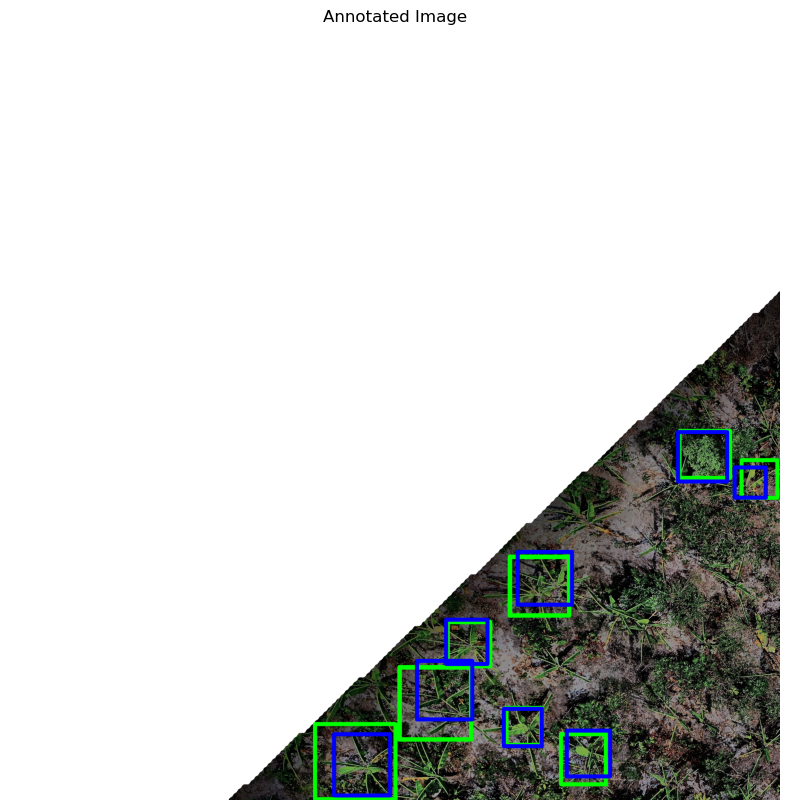

Annotated image saved to /path/to/save/annotated_images/Carlos Vera Arteaga RGB_0_0_0_4000_4000.png


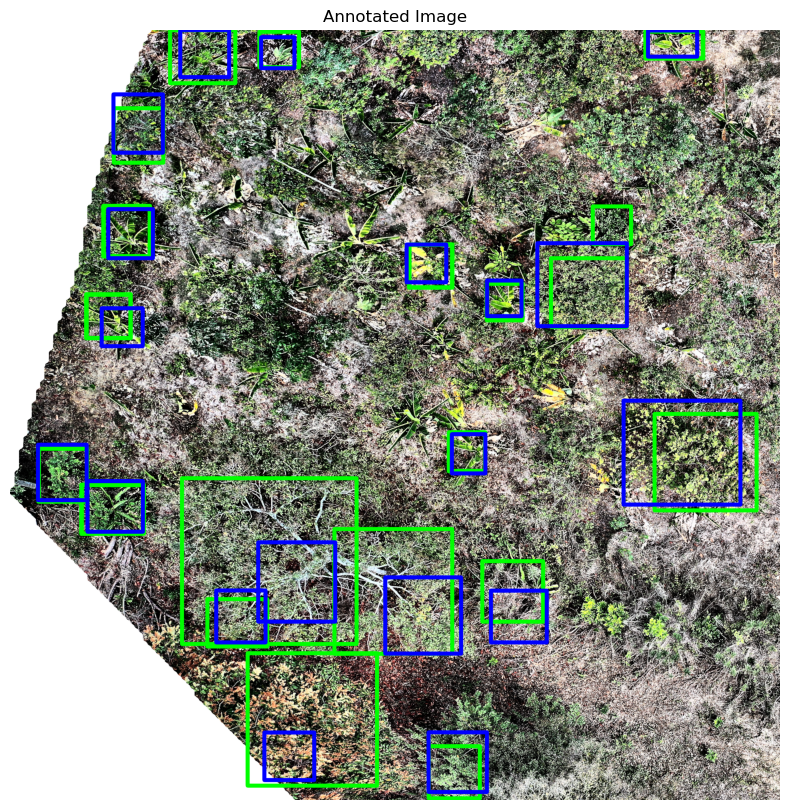

Annotated image saved to /path/to/save/annotated_images/Carlos Vera Arteaga RGB_2_0_7600_4000_11600.png


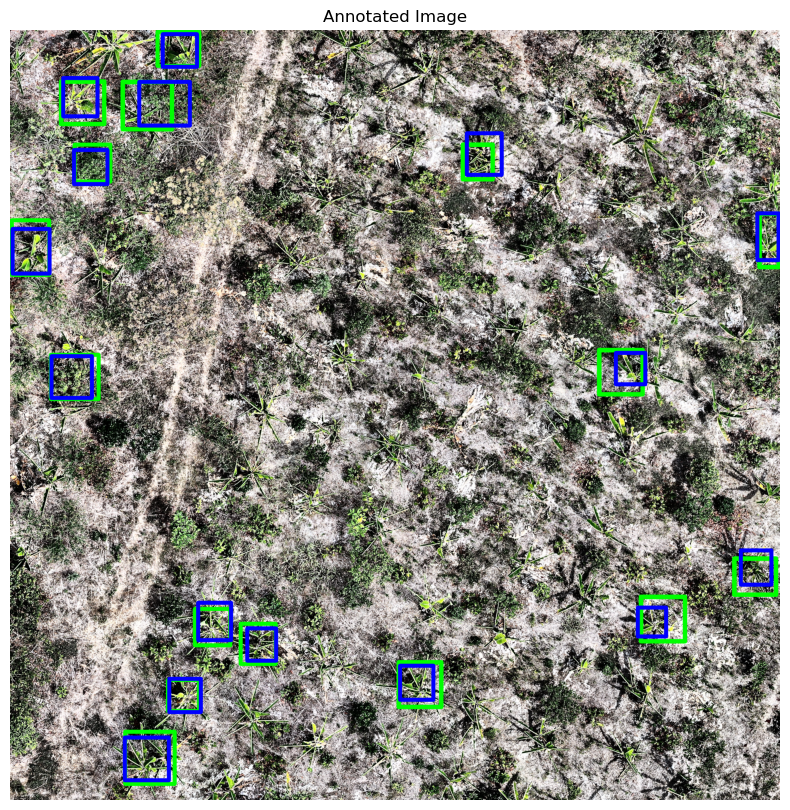

Annotated image saved to /path/to/save/annotated_images/Carlos Vera Arteaga RGB_5_3800_3800_7800_7800.png


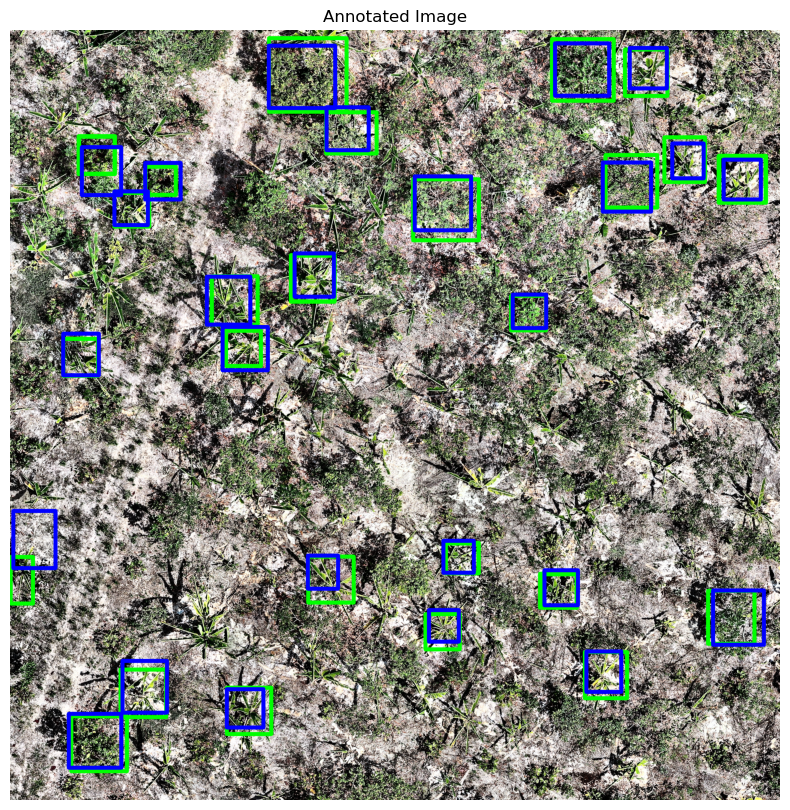

Annotated image saved to /path/to/save/annotated_images/Carlos Vera Arteaga RGB_9_7600_3800_11600_7800.png


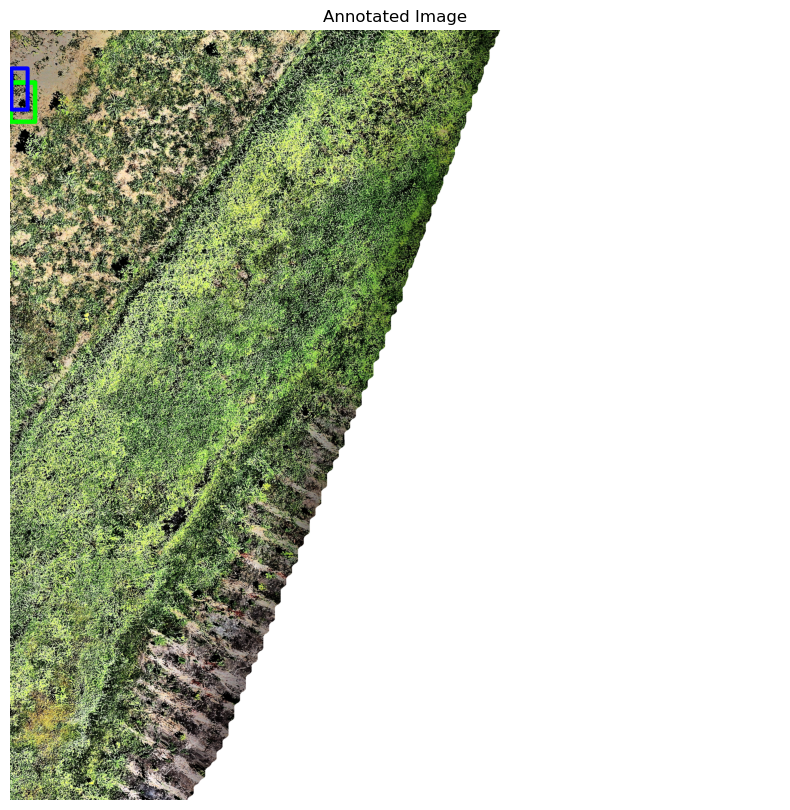

Annotated image saved to /path/to/save/annotated_images/Carlos Vera Guevara RGB_14_8425_7600_12425_11600.png


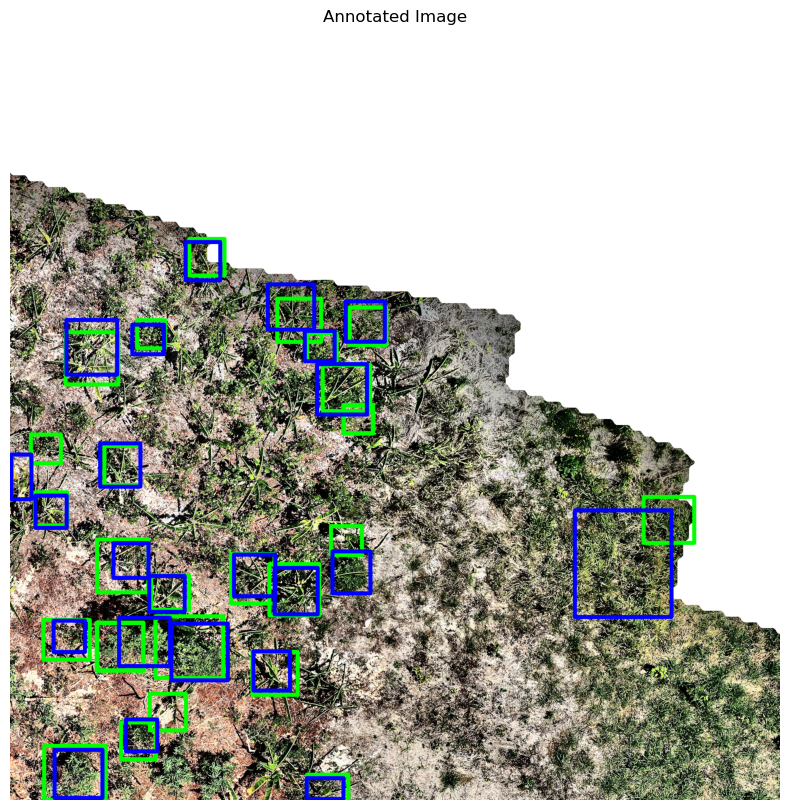

Annotated image saved to /path/to/save/annotated_images/Carlos Vera Guevara RGB_8_7600_0_11600_4000.png


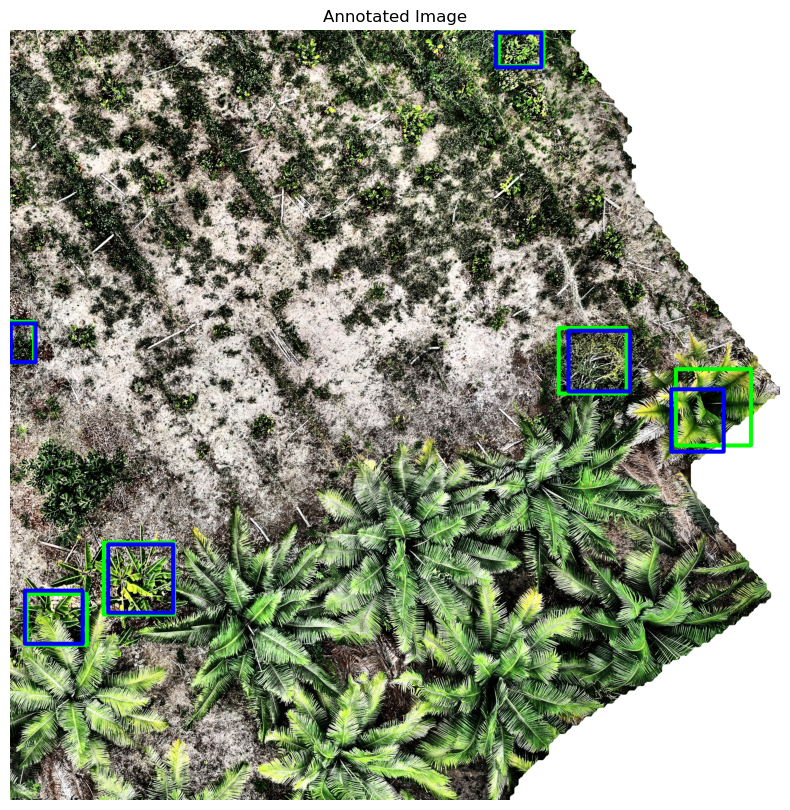

Annotated image saved to /path/to/save/annotated_images/Leonor Aspiazu RGB_17_13134_3800_17134_7800.png


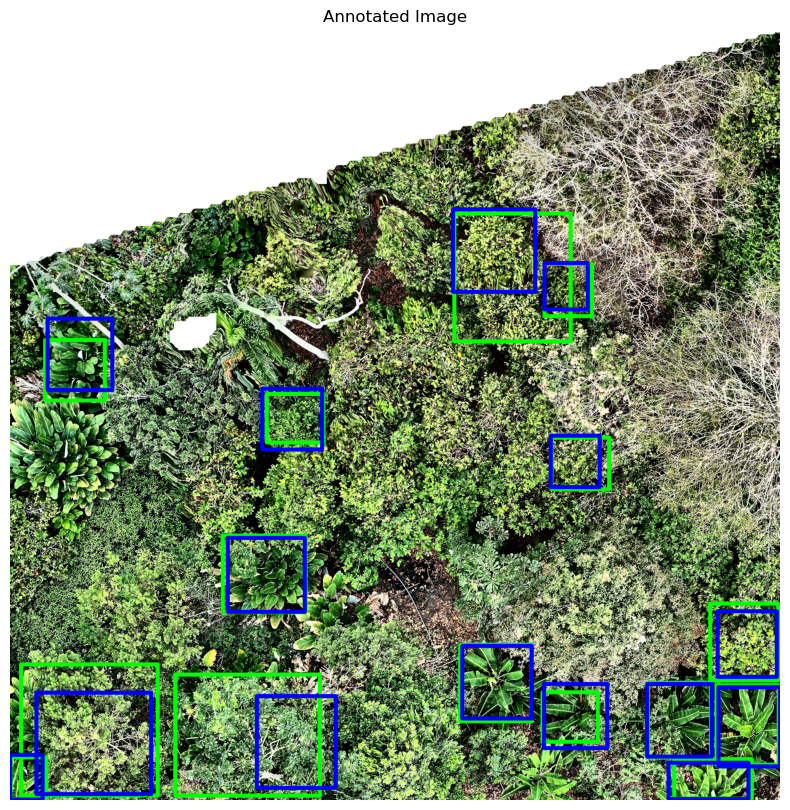

Annotated image saved to /path/to/save/annotated_images/Leonor Aspiazu RGB_8_7600_0_11600_4000.png


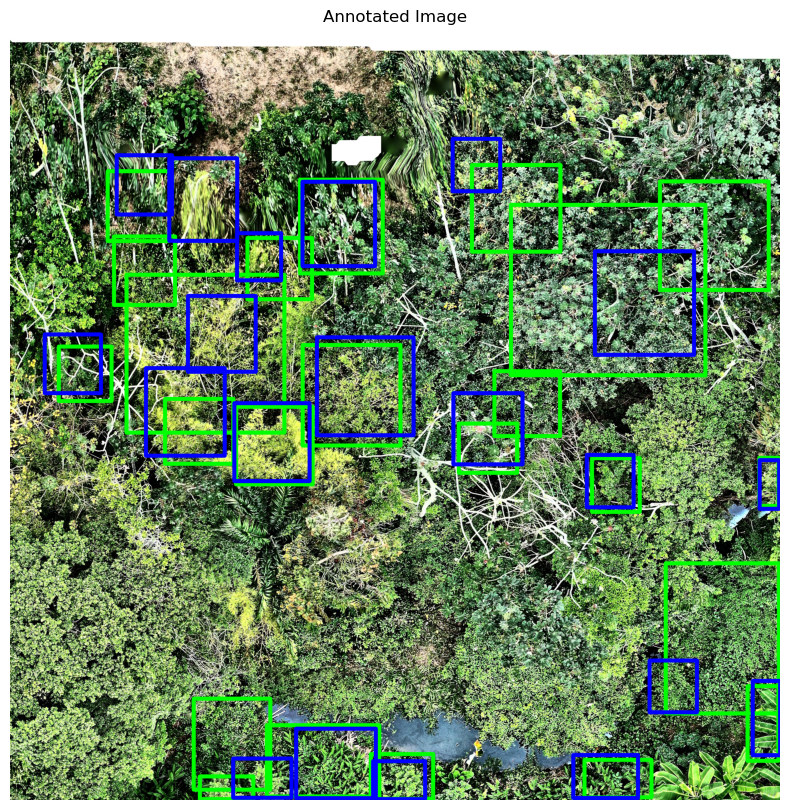

Annotated image saved to /path/to/save/annotated_images/Manuel Macias RGB_3_3800_0_7800_4000.png


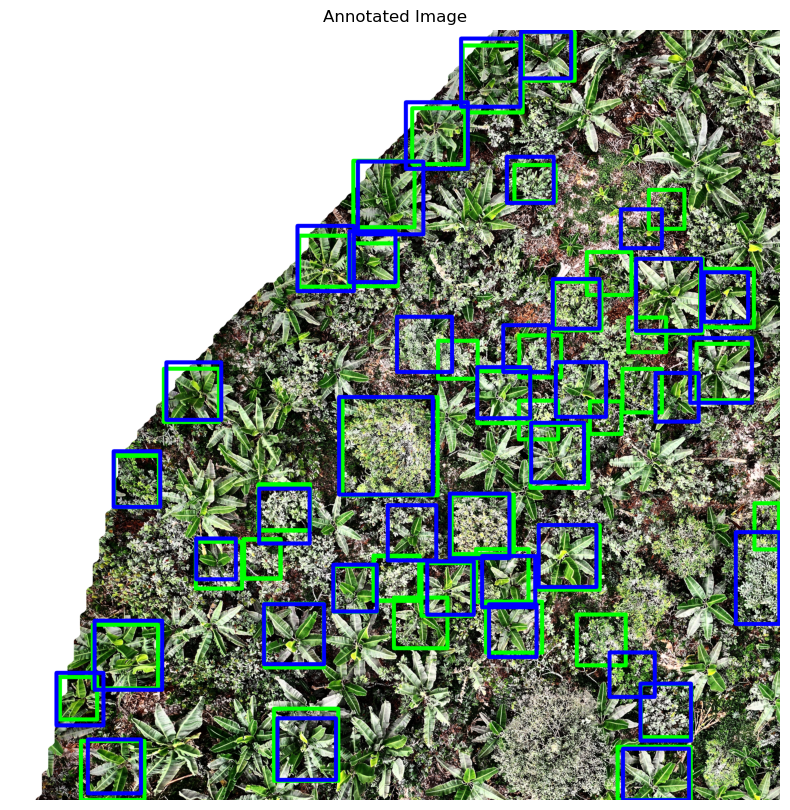

Annotated image saved to /path/to/save/annotated_images/Nestor Macias RGB_1_0_3800_4000_7800.png


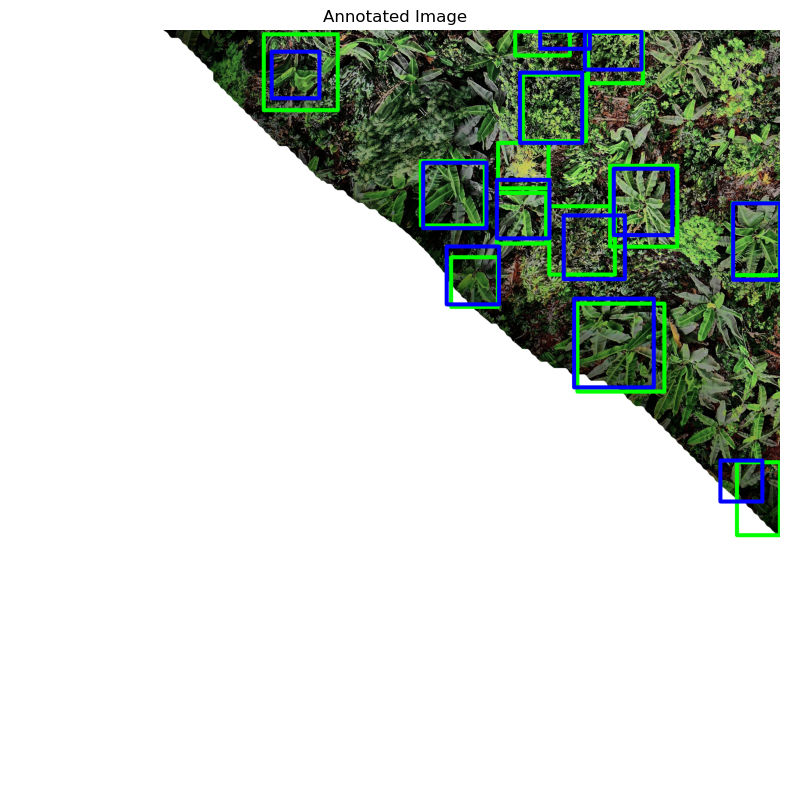

Annotated image saved to /path/to/save/annotated_images/Nestor Macias RGB_3_0_9024_4000_13024.png


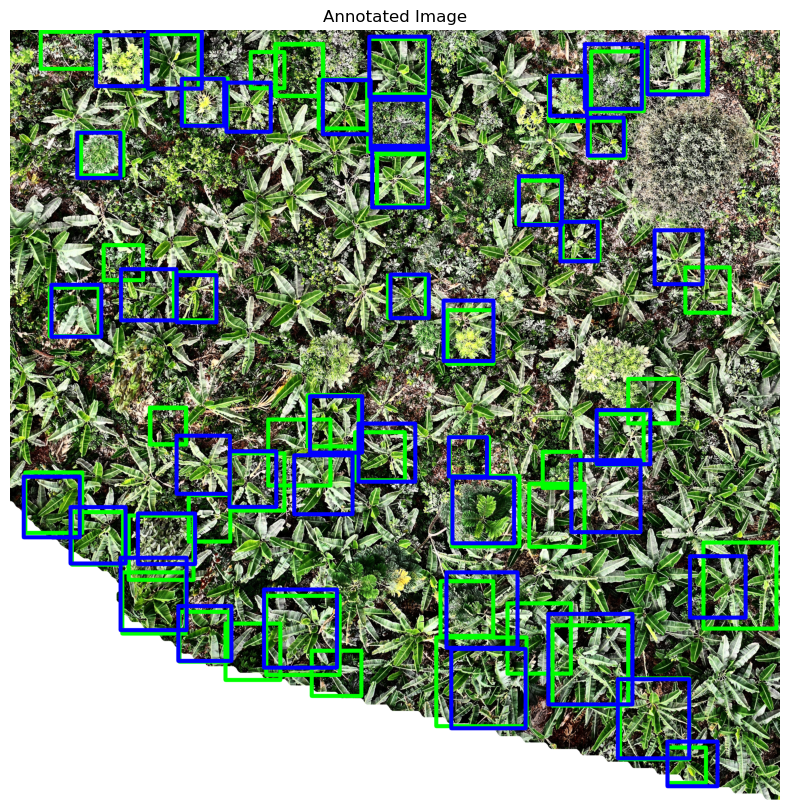

Annotated image saved to /path/to/save/annotated_images/Nestor Macias RGB_7_3800_9024_7800_13024.png


In [33]:
import pandas as pd
import cv2
from matplotlib import pyplot as plt
from PIL import Image

# Function to draw bounding boxes
def draw_boxes(image_path, root_dir, true_boxes, pred_boxes, save_path=None):
    """
    Draws true and predicted bounding boxes on an image.
    
    Args:
        image_path (str): The path to the image file.
        true_boxes (list of list): List of true bounding boxes [xmin, ymin, xmax, ymax].
        pred_boxes (list of list): List of predicted bounding boxes [xmin, ymin, xmax, ymax].
        save_path (str, optional): If provided, the annotated image will be saved to this path.
    """
    # Load the image using OpenCV
    image_path_full = os.path.join(root_dir, image_path)
    image = cv2.imread(image_path_full)

    # Check if the image was loaded correctly
    if image is None:
        print(f"Failed to load image: {image_path}")
        return

    # Draw true bounding boxes in green
    for box in true_boxes:
        xmin, ymin, xmax, ymax = map(int, box)
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (0, 255, 0), 20)  # Green for true boxes

    # Draw predicted bounding boxes in red
    for box in pred_boxes:
        xmin, ymin, xmax, ymax = map(int, box)
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (255, 0, 0), 20)  # Red for predicted boxes

    # Convert BGR to RGB for Matplotlib display
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.title("Annotated Image")
    plt.show()

    # Save the image if a save path is provided
    if save_path:
        cv2.imwrite(save_path, image)
        print(f"Annotated image saved to {save_path}")

# Assuming `iou_results_df` is the DataFrame containing the results
# and that each row has 'image_path', 'true_box_xmin', 'true_box_ymin', 'true_box_xmax', 'true_box_ymax',
# 'pred_box_xmin', 'pred_box_ymin', 'pred_box_xmax', 'pred_box_ymax'

# Group by image path and iterate through each group
for image_path, group in iou_results_df.groupby('image_path'):
    # Collect true and predicted boxes for the current image
    true_boxes = group[['true_box_xmin', 'true_box_ymin', 'true_box_xmax', 'true_box_ymax']].values.tolist()
    pred_boxes = group[['pred_box_xmin', 'pred_box_ymin', 'pred_box_xmax', 'pred_box_ymax']].values.tolist()
    
    # Specify the save path for the annotated image (optional)
    save_path = f"/path/to/save/annotated_images/{image_path.split('/')[-1]}"

    # Draw boxes and display/save the image
    draw_boxes(image_path, root_dir, true_boxes, pred_boxes, save_path)


In [34]:
#save results as a CSV
iou_results_df.to_csv('iou_results_deepforest.csv', index=False)